In [1]:
import torch
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import pickle

In [2]:
print(torch.cuda.is_available())

True


In [3]:
# Проверяем, доступны ли GPU
device = 'cuda' if torch.cuda.is_available() else 'cpu'

In [ ]:
# Загрузка DataFrame из файла
with open(r'../datasets/seg_maps_dataset.pkl', 'rb') as f:
    df = pickle.load(f)

In [62]:
count_values = df['Crystal'].value_counts()
print(count_values)
count_values = df['Stats'].value_counts()
print(count_values)
count_values = df['Pulce duration'].value_counts()
print(count_values)

Crystal
Al                120
Al2O3_sapphire    120
Ba                120
Be                120
BeO               120
C_diamond         120
C_graphite        120
Cr                120
Cs                120
Cu                120
Cu2MnAl           120
Fe                120
Ga                120
Ge                120
He4_hcp           120
I2                120
K                 120
Mo                120
Na2Ca3Al2F14      120
Nb                120
Ni                120
Pb                120
Pt                120
Rb                120
Si                120
Ti                120
Tl                120
UO2               120
Zn                120
Y2O3              120
Name: count, dtype: int64
Stats
10000000.0     600
20000000.0     600
50000000.0     600
100000000.0    600
200000000.0    600
500000000.0    600
Name: count, dtype: int64
Pulce duration
10.000000     180
25.263158     180
40.526316     180
55.789474     180
71.052632     180
86.315789     180
101.578947    180
116.842105    180
1

In [5]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

X = df.drop(['Crystal', 'Stats', 'Pulce duration'], axis=1)

# Шаг 1: Преобразование строковых меток классов в числовые метки
label_encoder = LabelEncoder()

Stats = df['Stats']

y = df['Crystal']

y_encoded = label_encoder.fit_transform(y)

Diff_train, Diff_test, Stats_train, Stats_test, y_train, y_test = train_test_split(X, Stats, y_encoded, test_size=0.1, random_state=42)

In [29]:
Crystal_types = df['Crystal'].unique()

In [10]:
Stats.unique()

array([1.e+07, 2.e+07, 5.e+07, 1.e+08, 2.e+08, 5.e+08])

In [6]:
# Преобразование матриц в numpy массив перед преобразованием в тензоры
Diff_train_matrices = np.array(Diff_train['Matrix'].tolist())
Diff_test_matrices = np.array(Diff_test['Matrix'].tolist())

Stats_train_matrices = np.array(Stats_train.tolist())
Stats_test_matrices = np.array(Stats_test.tolist())

# Преобразование данных в тензоры PyTorch
Diff_train_tensor = torch.FloatTensor(Diff_train_matrices)
Diff_train_tensor = Diff_train_tensor.unsqueeze(1)
Stats_train_tensor = torch.FloatTensor(Stats_train_matrices)
#Segmentation_Diff_train_tensor = Segmentation_Diff_train_tensor.unsqueeze(1)
y_train_tensor = torch.LongTensor(y_train)  # Используем LongTensor для целевых меток

Diff_test_tensor = torch.FloatTensor(Diff_test_matrices)
Diff_test_tensor = Diff_test_tensor.unsqueeze(1)
Stats_test_tensor = torch.FloatTensor(Stats_test_matrices)
#Segmentation_Diff_test_tensor = Segmentation_Diff_test_tensor.unsqueeze(1)
y_test_tensor = torch.LongTensor(y_test)

In [7]:
mean = torch.mean(Stats_train_tensor)
std = torch.std(Stats_train_tensor)

Stats_train_tensor = (Stats_train_tensor - mean) / std
Stats_test_tensor = (Stats_test_tensor - mean) / std

In [8]:
from torch.utils.data import TensorDataset, DataLoader, random_split

# Создание набора данных
train_dataset = TensorDataset(Diff_train_tensor, Stats_train_tensor, y_train_tensor)

test_dataset = TensorDataset(Diff_test_tensor, Stats_test_tensor, y_test_tensor)

# Создание DataLoader для каждой выборки
train_loader = DataLoader(train_dataset, batch_size=1, shuffle=True)

test_loader = DataLoader(test_dataset, batch_size=1, shuffle=False)

In [ ]:
import GAN_models
import torch
import torch.nn as nn
import torch.nn.functional as F

# Пример объединения условного вектора
def create_condition_vector(crystal, stats, embedding_layer_crystal):
    # Преобразование Crystal в числовой вектор
    crystal_encoded = embedding_layer_crystal(crystal)  # Например, [batch_size, embedding_dim]
    
    # Преобразование Stats в столбец для правильного объединения с crystal_encoded
    stats = stats.unsqueeze(1)  # Преобразует [batch_size] в [batch_size, 1]
    #stats_encoded = embedding_layer_stats(stats)
    
    # Объединение для создания полного условного вектора
    #condition = torch.cat([crystal_encoded, stats], dim=1)
    condition = torch.cat([crystal_encoded, stats], dim=1)
    return condition

# Определяем embedding_layer
num_crystal_types = 30  # Укажите количество уникальных значений для Crystal
embedding_dim = 1100      # Размерность встраивания, можно менять в зависимости от задачи
num_stats_types = 6

#embedding_layer_crystal = nn.Embedding(num_crystal_types, embedding_dim)

#embedding_layer_crystal.to(device)

# Параметры
noise_dim = 1100  # Размерность шума (z)
condition_dim = 1100 + 1  # Размерность условного вектора (embedding_dim + stats), пример: 10 для Crystal + 1 для Stats
output_shape = (1, 250, 480)  # Размерность изображения (дифракционный паттерн)

checkpoint = torch.load('../models/model_checkpoint.pth')
GAN_generator= GAN_models.ConvGenerator(noise_dim, condition_dim, output_shape).to(device)
GAN_generator.load_state_dict(checkpoint['generator_state_dict'])
GAN_generator.eval()  # Перевод в режим инференса

embedding_layer_crystal = nn.Embedding(num_crystal_types, embedding_dim)
embedding_layer_crystal.to(device)
embedding_layer_crystal.load_state_dict(checkpoint['embedding_state_dict'])

<All keys matched successfully>

In [11]:
#array([1.e+07, 2.e+07, 5.e+07, 1.e+08, 2.e+08, 5.e+08])
maxStats = 5.e+08
minI = max(df['Pulce duration'].unique())

df_test = df.loc[((df['Stats'] == maxStats) & (df['Pulce duration'] == minI))]
df_test = df_test.reset_index(drop= True)

Crystal_tags = df_test['Crystal']

Crystal_tags_encoded = label_encoder.fit_transform(Crystal_tags)

Crystal_tags_encoded = torch.LongTensor(Crystal_tags_encoded)
Crystal_tags_encoded = Crystal_tags_encoded.to(device)

#segment_df_test = segment_df.loc[((segment_df['Stats'] == maxStats) & (segment_df['Pulce duration'] == minI))]
#segment_df_test = segment_df_test.reset_index(drop= True)

# Преобразование матриц в numpy массив перед преобразованием в тензоры
df_test_matrices = np.array(df_test['Matrix'].tolist())

# Преобразование данных в тензоры PyTorch
df_test_tensor = torch.FloatTensor(df_test_matrices)
df_test_tensor = df_test_tensor.unsqueeze(1)

#Segmenation_df_test_tensor = torch.FloatTensor(Segmenation_df_test_matrices)
#Segmenation_df_test_tensor = Segmenation_df_test_tensor.unsqueeze(1)

df_test_tensor = df_test_tensor.to(device)
#Segmenation_df_test_tensor.size()
df_test_tensor.size()

df_test_tensor = df_test_tensor.to(device)

[0]


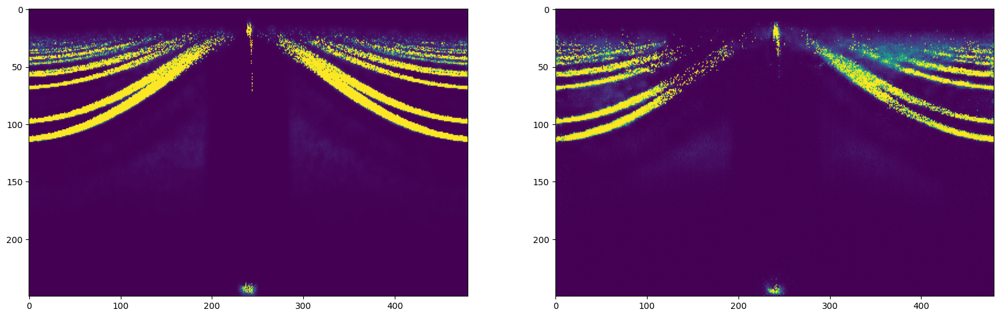

[1]


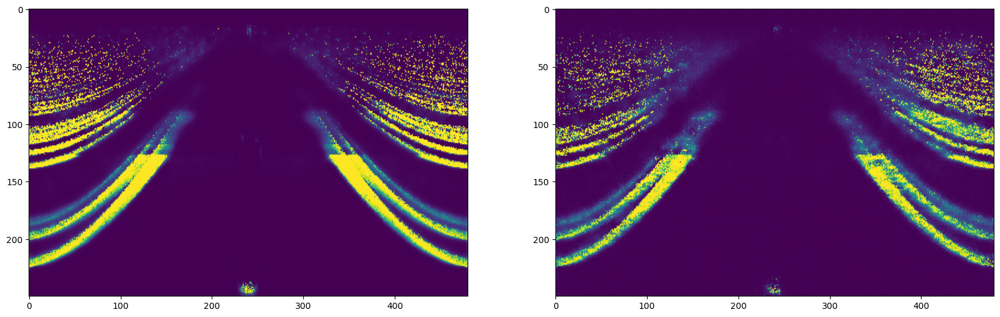

[2]


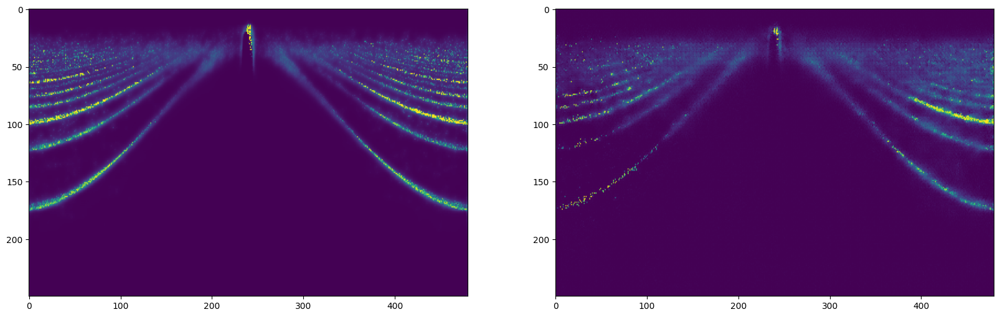

[3]


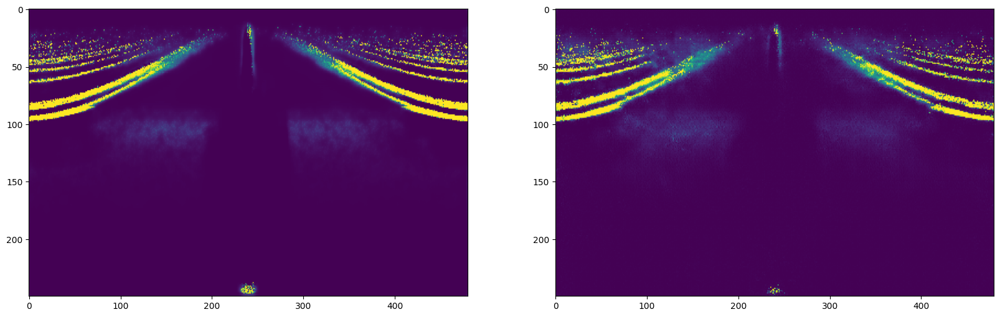

[4]


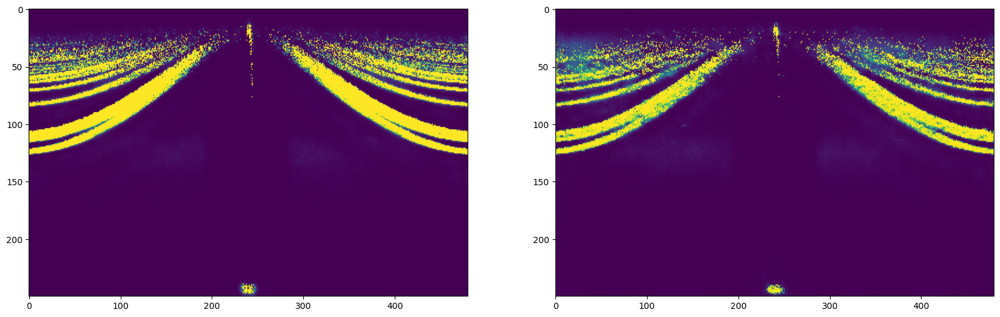

[5]


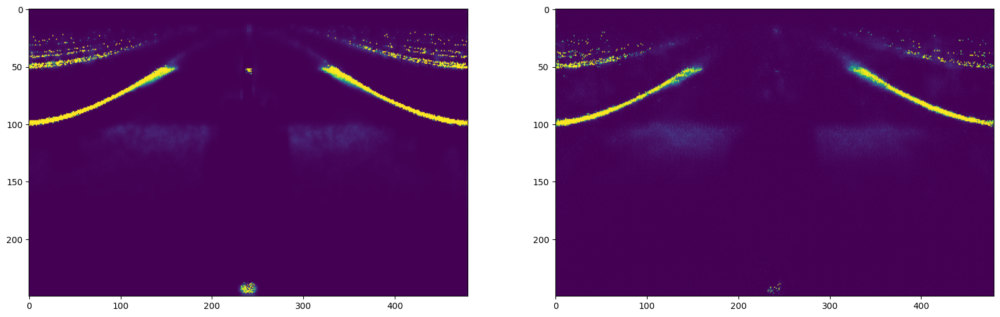

[6]


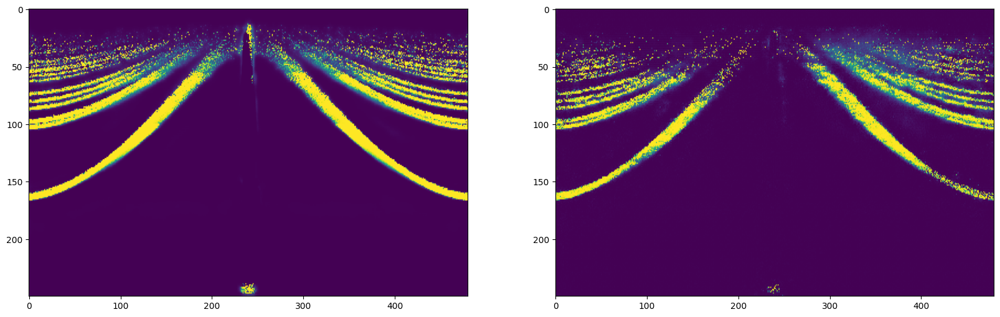

[7]


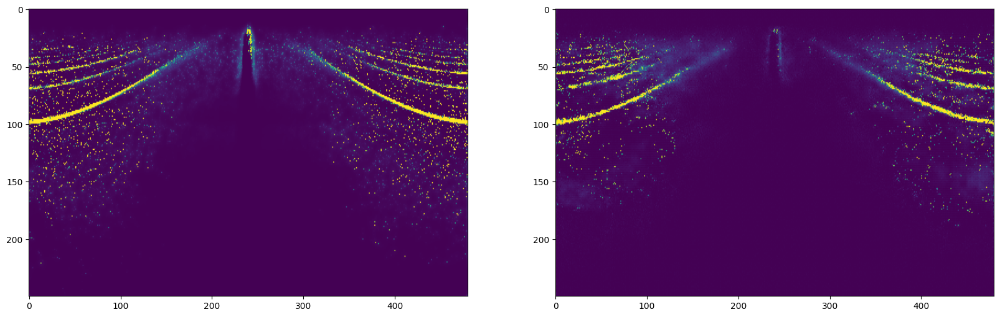

[8]


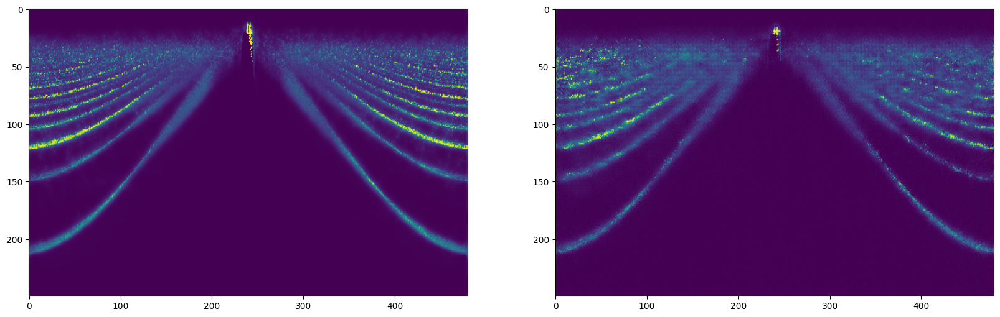

[9]


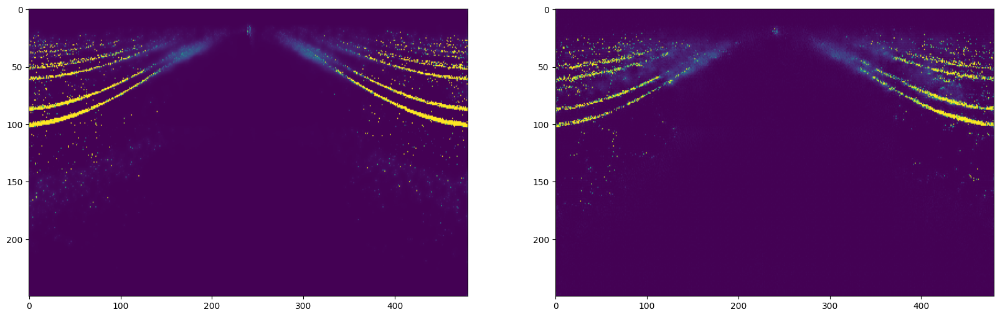

[10]


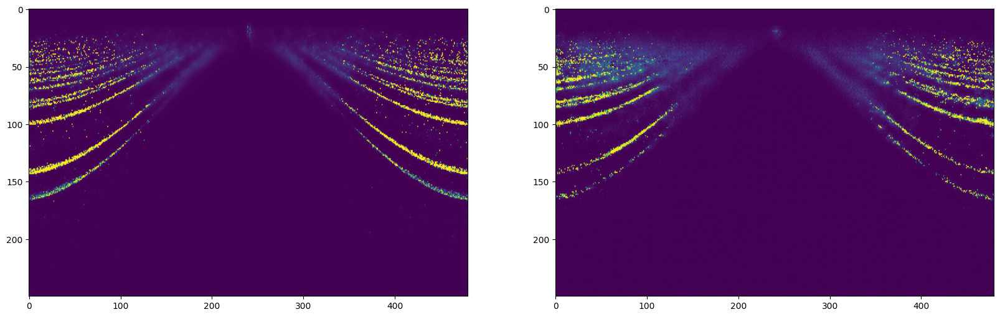

[11]


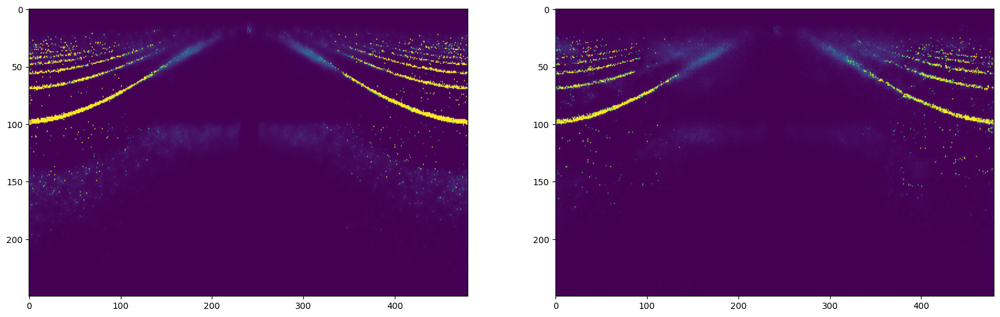

[12]


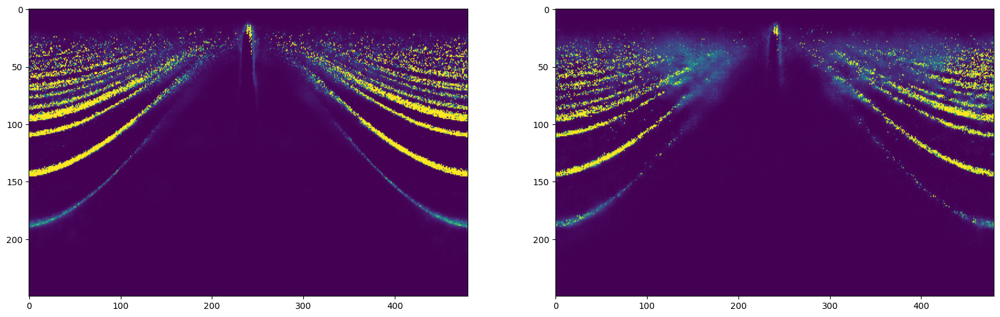

[13]


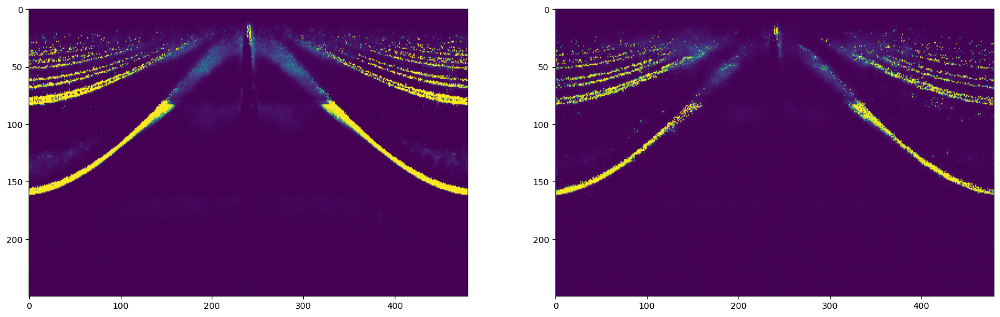

[14]


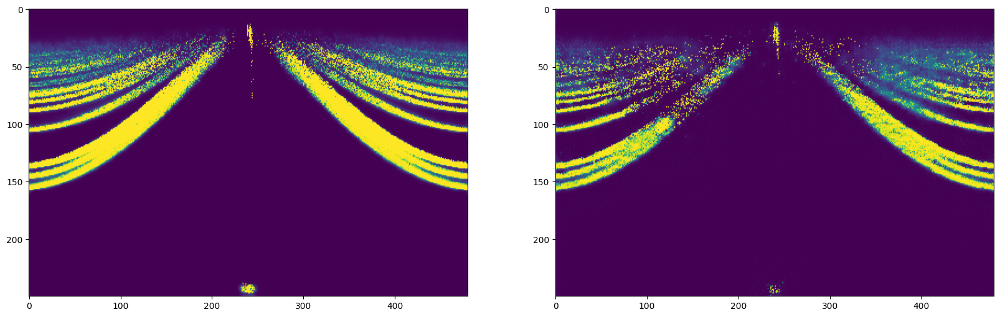

[15]


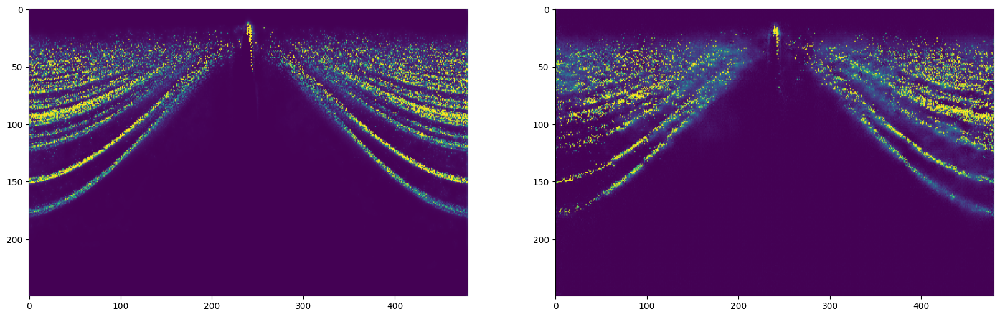

[16]


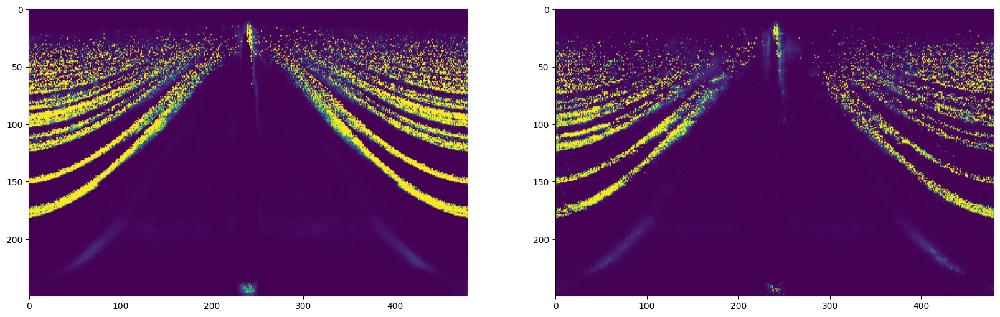

[17]


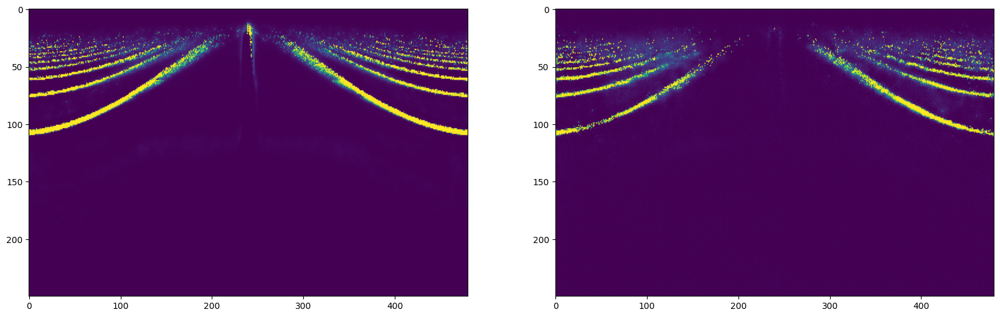

[18]


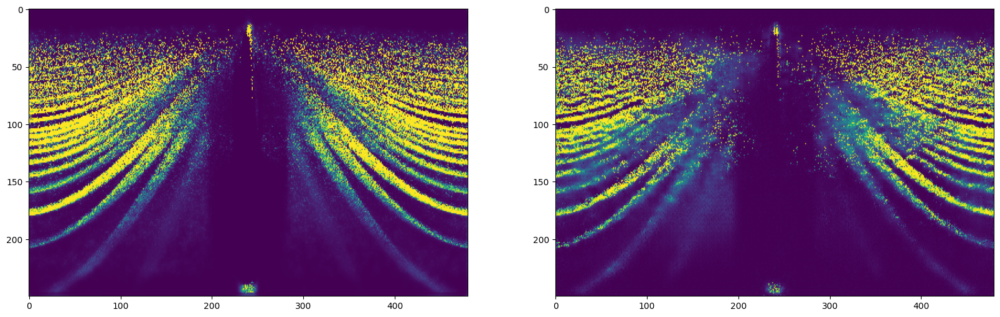

[19]


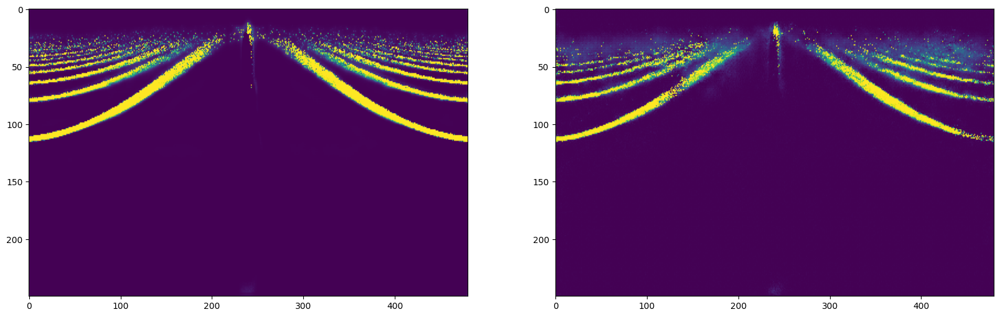

[20]


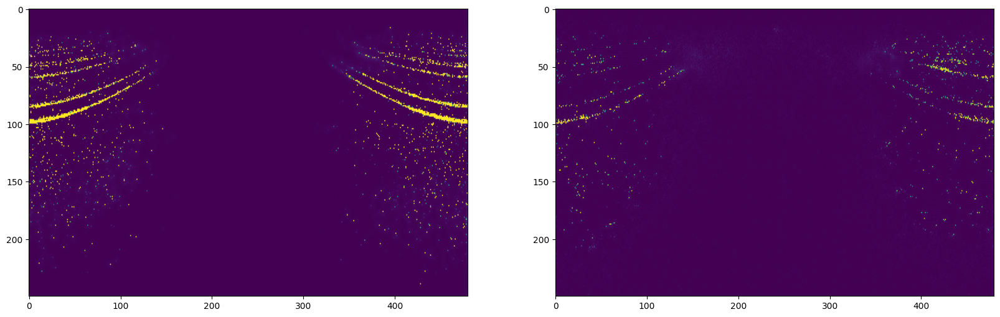

[21]


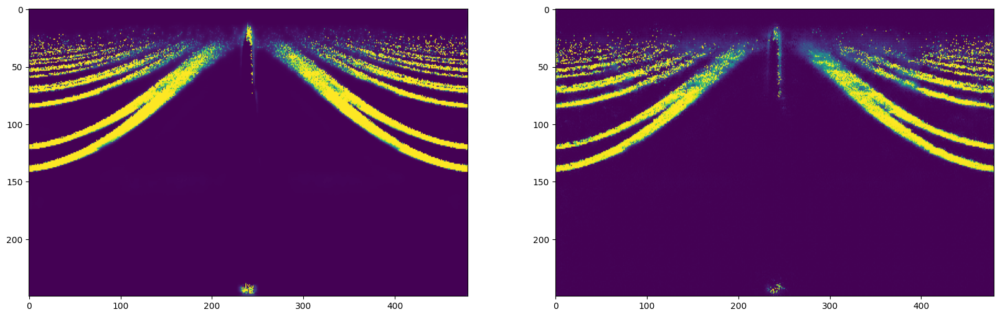

[22]


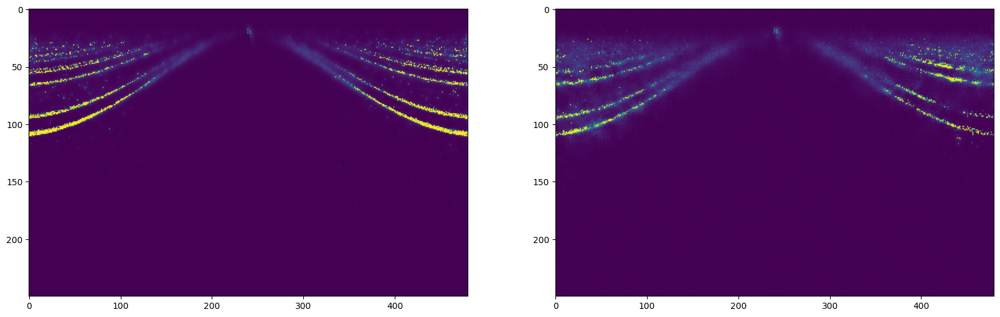

[23]


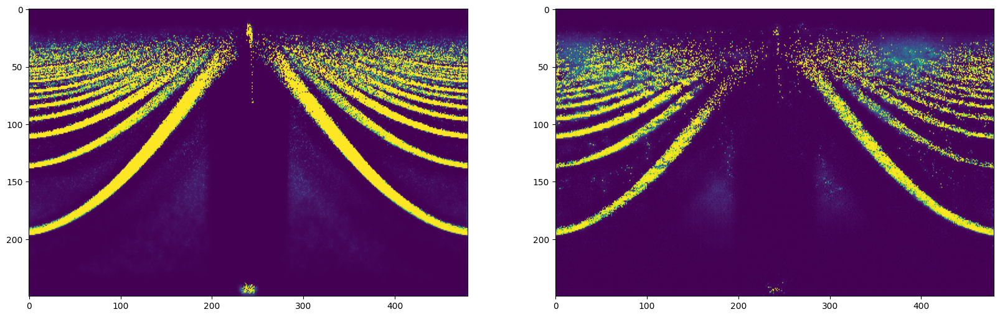

[24]


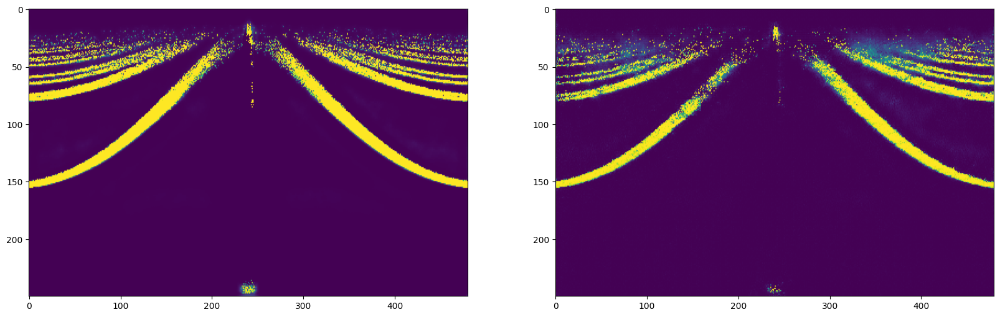

[25]


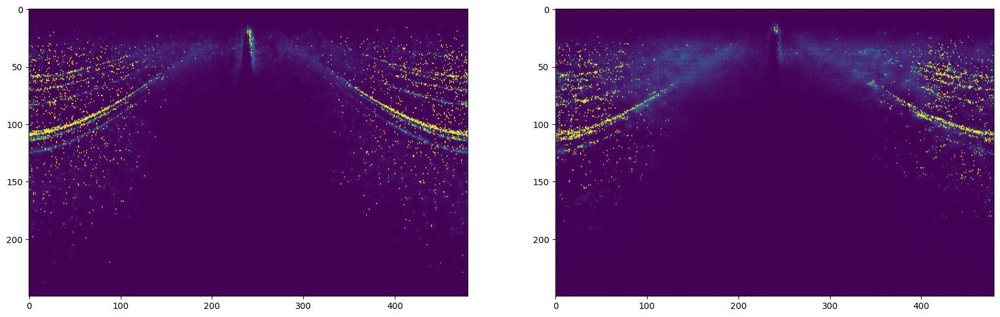

[26]


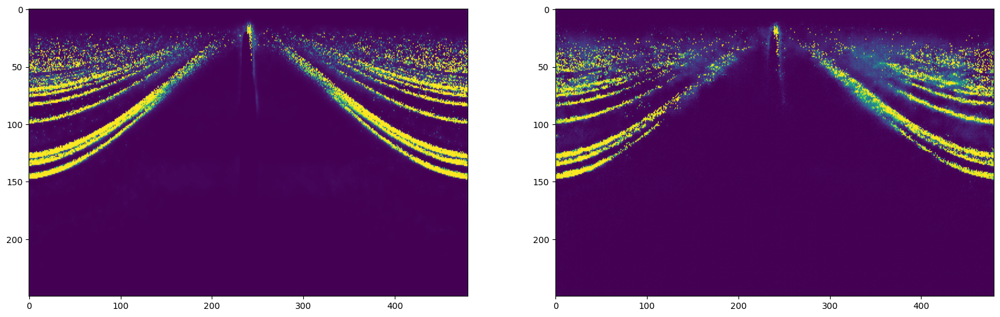

[27]


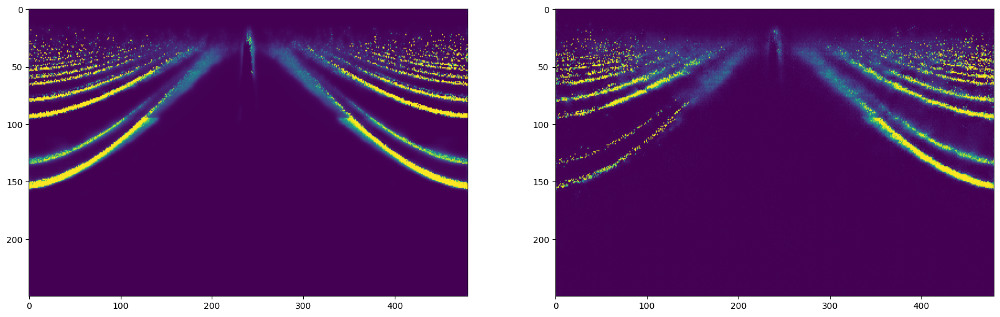

[28]


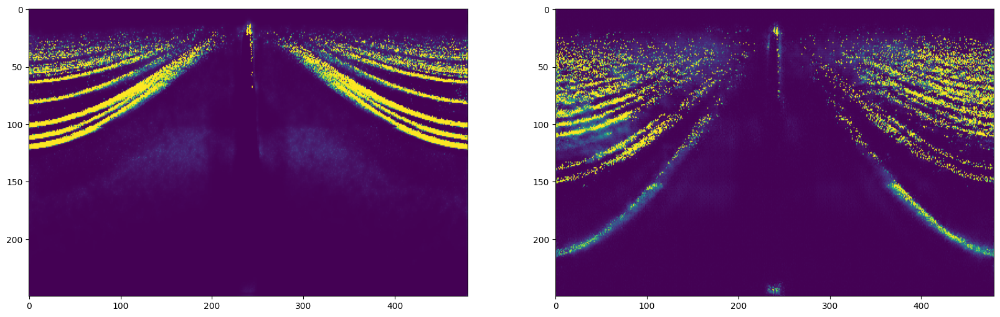

[29]


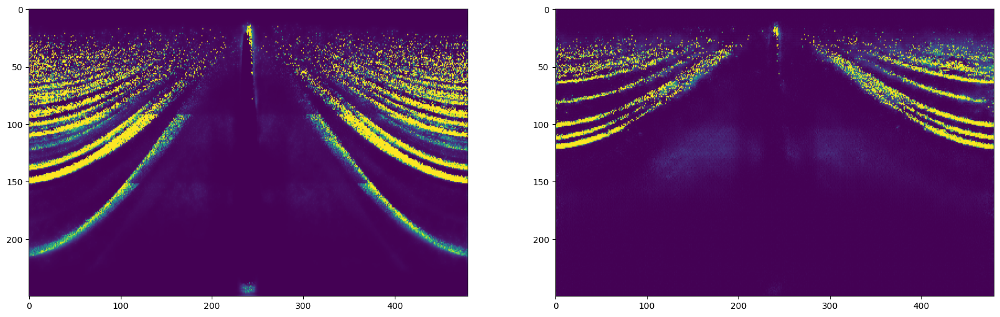

In [15]:
#array([1.e+07, 2.e+07, 5.e+07, 1.e+08, 2.e+08, 5.e+08])
sample_stats = [5.e+08]
sample_stats = torch.FloatTensor(sample_stats)
sample_stats = (sample_stats - mean)/std
sample_stats = sample_stats.to(device)

sample_stats_1 = [5.e+08]
sample_stats_1 = torch.FloatTensor(sample_stats_1)
sample_stats_1 = (sample_stats_1 - mean)/std
sample_stats_1 = sample_stats_1.to(device)

sample_stats_array = [sample_stats.cpu(), sample_stats_1.cpu()]

with torch.no_grad():
    for i in range(len(df_test_tensor)):
        sample_crystal = [i]
        print(sample_crystal)
        sample_crystal = torch.LongTensor(sample_crystal)
        sample_crystal = sample_crystal.to(device)
        noise = torch.randn(sample_crystal.size(0), noise_dim).to(device)
        condition = create_condition_vector(sample_crystal, sample_stats, embedding_layer_crystal)
        fake_images = GAN_generator(noise, condition)

        # Создаем фигуру и оси
        fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 6))

        # Первый график
        ax1.imshow(df_test_tensor[i][0].cpu().numpy(), cmap='viridis', aspect='auto')

        # Первый график
        ax2.imshow(abs(fake_images[0][0].cpu().numpy()), cmap='viridis', aspect='auto')

        plt.show()

In [36]:
import numpy as np
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns

# Списки для хранения данных
real_features = []
fake_features = []
labels = []  # для цветовой маркировки (например, по химическому элементу)

with torch.no_grad():
    for real_images, stats, crystals in train_loader:
        # Перенос данных на устройство
        if stats in sample_stats_array:
            stats = stats.to(device)
            crystals = crystals.to(device)
            real_images = real_images.to(device)
            
            # Условия генерации
            condition = create_condition_vector(crystals, stats, embedding_layer_crystal)
            
            # Генерация фейковых изображений
            latent = torch.randn(real_images.size(0), noise_dim).to(device)
            fake_images = GAN_generator(latent, condition)
            
            # Преобразуем изображения в признаки (например, вытягиваем в вектор)
            real_flat = real_images.view(real_images.size(0), -1).cpu().numpy()  # [batch_size, H*W]
            fake_flat = fake_images.view(fake_images.size(0), -1).cpu().numpy()
            
            real_features.append(real_flat)
            fake_features.append(fake_flat)
            labels.append(crystals.cpu().numpy())  # или stats, если хотим маркировать по статистике

# Объединяем все батчи
real_features = np.concatenate(real_features, axis=0)
fake_features = np.concatenate(fake_features, axis=0)
labels = np.concatenate(labels, axis=0)

# Создаем общий датасет (реальные + фейковые)
all_features = np.concatenate([real_features, fake_features], axis=0)
all_labels = np.concatenate([
    label_encoder.inverse_transform(labels),  # метки реальных данных
    label_encoder.inverse_transform(labels)   # метки фейковых (можно изменить, если нужно)
])
data_type = np.array(['Real'] * len(real_features) + ['Fake'] * len(fake_features))

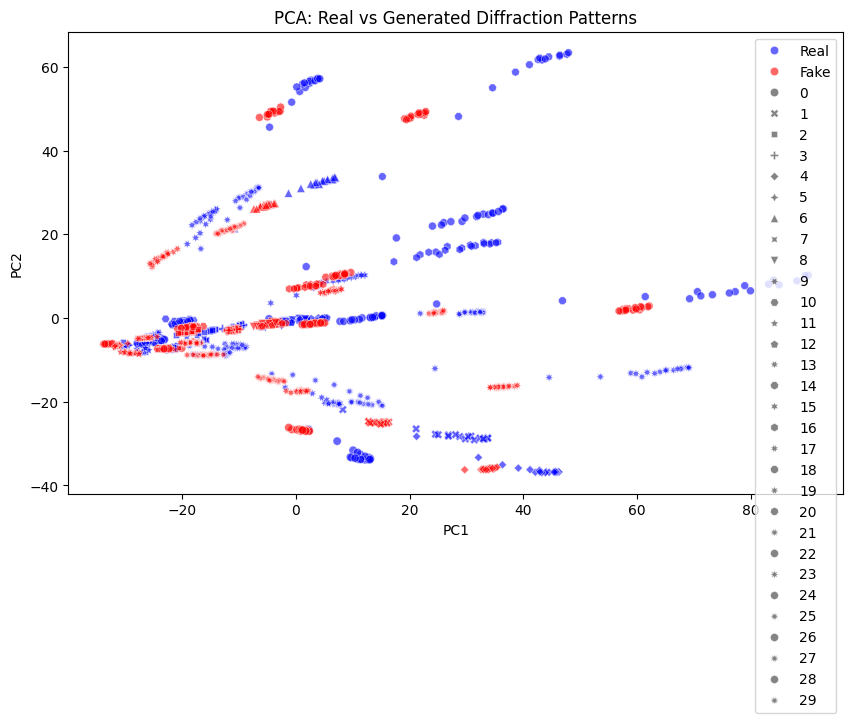

In [25]:
# Применяем PCA для уменьшения размерности до 2D
pca = PCA(n_components=2)
pca_result = pca.fit_transform(all_features)

# Визуализация
plt.figure(figsize=(10, 6))
sns.scatterplot(
    x=pca_result[:, 0], y=pca_result[:, 1],
    hue=data_type,  # разделяем Real/Fake
    style=all_labels,  # разделяем по классам (химическим элементам)
    palette={'Real': 'blue', 'Fake': 'red'},
    alpha=0.6
)
plt.title("PCA: Real vs Generated Diffraction Patterns")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.legend()
plt.show()

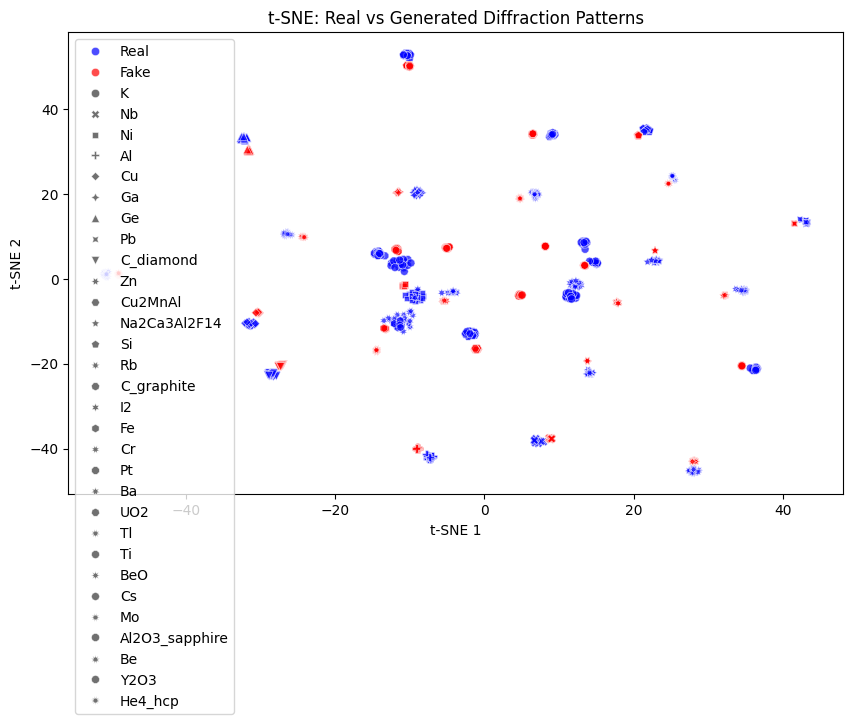

In [37]:
# Уменьшаем выборку для t-SNE (если данных много)
subset_size = 1000  # возьмем по 500 из реальных и фейковых
indices = np.random.choice(len(all_features), subset_size, replace=False)
#tsne_features = all_features[indices]
#tsne_labels = all_labels[indices]
#tsne_data_type = data_type[indices]

# Запуск t-SNE
tsne = TSNE(n_components=2, perplexity=30, random_state=42)
tsne_result = tsne.fit_transform(all_features)

# Визуализация
plt.figure(figsize=(10, 6))
sns.scatterplot(
    x=tsne_result[:, 0], y=tsne_result[:, 1],
    hue=data_type,
    style=all_labels,
    palette={'Real': 'blue', 'Fake': 'red'},
    alpha=0.7
)
plt.title("t-SNE: Real vs Generated Diffraction Patterns")
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")
plt.legend()
plt.show()

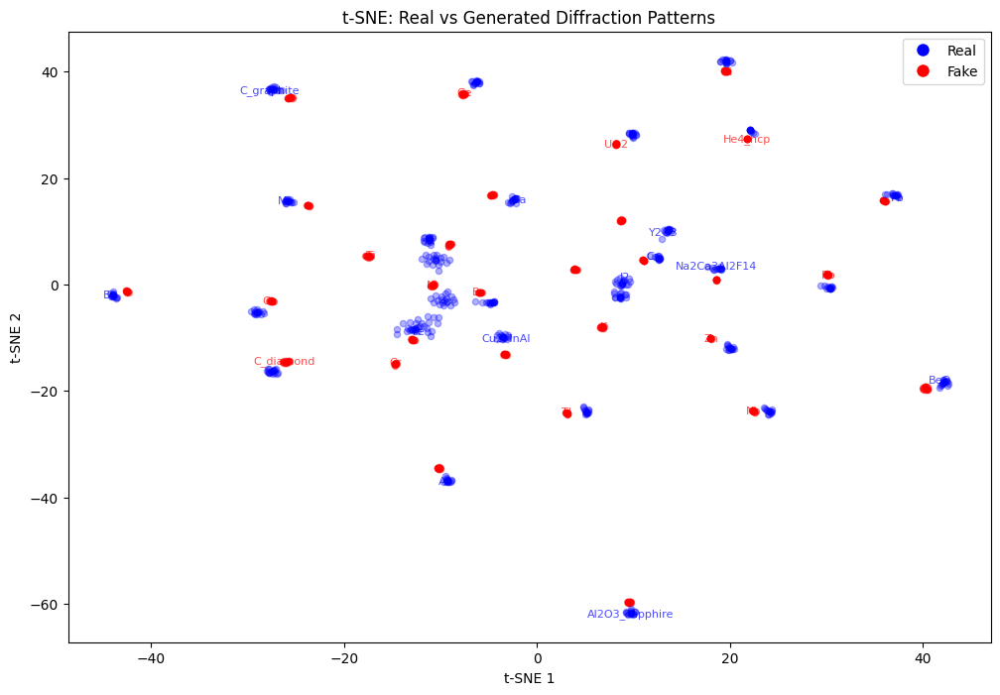

In [39]:
# Альтернативный вариант: показывать только уникальные комбинации
plt.figure(figsize=(12, 8))

# Создаем словарь для отслеживания уже отображенных меток
displayed_labels = set()

for i in range(len(tsne_result)):
    x = tsne_result[i, 0]
    y = tsne_result[i, 1]
    label = tsne_labels[i]
    data_type_color = color_map[tsne_data_type[i]]
    
    # Показываем метку только если она еще не отображалась
    if label not in displayed_labels:
        plt.text(x, y, label, 
                 color=data_type_color, 
                 fontsize=8, 
                 alpha=0.7,
                 ha='center', va='center')
        displayed_labels.add(label)
    else:
        # Для повторяющихся меток показываем точки
        plt.scatter(x, y, color=data_type_color, alpha=0.3, s=20)

plt.title("t-SNE: Real vs Generated Diffraction Patterns")
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")
plt.legend(handles=legend_elements)
plt.show()

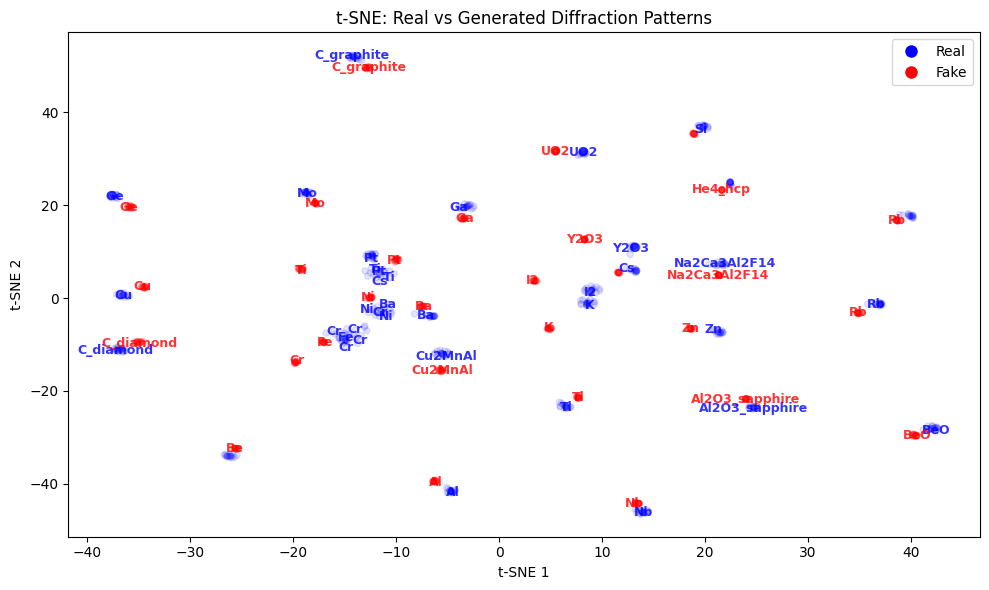

In [45]:
# Уменьшаем выборку для t-SNE
subset_size = 1080
indices = np.random.choice(len(all_features), subset_size, replace=False)
tsne_features = all_features[indices]
tsne_labels = all_labels[indices]
tsne_data_type = data_type[indices]

# Запуск t-SNE
tsne = TSNE(n_components=2, perplexity=30, random_state=42)
tsne_result = tsne.fit_transform(tsne_features)

# Визуализация
plt.figure(figsize=(10, 6))

# Создаем словарь цветов для типов данных
color_map = {'Real': 'blue', 'Fake': 'red'}

# Сначала рисуем все точки прозрачными (только для структуры)
plt.scatter(tsne_result[:, 0], tsne_result[:, 1], 
           alpha=0.1, s=20, c=[color_map[t] for t in tsne_data_type])

# Затем добавляем текстовые метки только для уникальных классов
displayed_labels = set()
label_positions = {}  # Для хранения позиций уже отображенных меток

for i in range(len(tsne_result)):
    x = tsne_result[i, 0]
    y = tsne_result[i, 1]
    label = tsne_labels[i]
    data_type_color = color_map[tsne_data_type[i]]
    
    # Проверяем, достаточно ли далеко от других меток
    too_close = False
    for existing_pos in label_positions.get(label, []):
        if np.sqrt((x - existing_pos[0])**2 + (y - existing_pos[1])**2) < 2:  # Пороговое расстояние
            too_close = True
            break
    
    if not too_close:
        plt.text(x, y, label, 
                 color=data_type_color, 
                 fontsize=9, 
                 alpha=0.8,
                 ha='center', va='center',
                 weight='bold')
        
        # Сохраняем позицию для этого класса
        if label not in label_positions:
            label_positions[label] = []
        label_positions[label].append((x, y))
        displayed_labels.add(label)

plt.title("t-SNE: Real vs Generated Diffraction Patterns")
plt.xlabel("t-SNE 1")
plt.ylabel("t-SNE 2")

# Создаем легенду
legend_elements = [plt.Line2D([0], [0], marker='o', color='w', 
                             markerfacecolor='blue', markersize=10, label='Real'),
                  plt.Line2D([0], [0], marker='o', color='w', 
                             markerfacecolor='red', markersize=10, label='Fake')]
plt.legend(handles=legend_elements)

plt.tight_layout()
plt.show()

In [46]:
ResNet_classifier = torch.load('ResNet-18_diffraction.pth', weights_only=False)
ResNet_classifier.eval()
ResNet_classifier.to(device)

ResNet(
  (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
    (1): BasicBlock(
      (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
  

In [49]:
import torch.nn.functional as F

def psnr(img1, img2, data_range=1.0):
    """
    Вычисляет PSNR между двумя изображениями.
    
    img1, img2: тензоры размера [N, C, H, W] с диапазоном значений [0, data_range].
    data_range: максимальное возможное значение пикселя (например, 1.0, если изображение нормировано).
    """
    mse = torch.mean((img1 - img2) ** 2)
    if mse == 0:
        return float('inf')
    return 10 * torch.log10((data_range ** 2) / mse)


def gaussian(window_size, sigma):
    """
    Генерирует одномерное гауссово окно.
    """
    coords = torch.arange(window_size).float() - window_size // 2
    g = torch.exp(-(coords ** 2) / (2 * sigma ** 2))
    return g / g.sum()


def create_window(window_size, channel, sigma):
    """
    Создаёт 2D гауссово окно для сверточного вычисления SSIM.
    """
    _1D_window = gaussian(window_size, sigma).unsqueeze(1)
    _2D_window = _1D_window @ _1D_window.t()  # матричное произведение для получения 2D окна
    _2D_window = _2D_window.float().unsqueeze(0).unsqueeze(0)
    window = _2D_window.expand(channel, 1, window_size, window_size)
    return window


def ssim(img1, img2, window_size=11, sigma=1.5, data_range=1.0, size_average=True):
    """
    Вычисляет SSIM между двумя изображениями.
    
    img1, img2: тензоры размера [N, C, H, W] с диапазоном значений [0, data_range].
    window_size: размер гауссова окна (обычно 11).
    sigma: стандартное отклонение для гауссова окна (обычно 1.5).
    size_average: если True, возвращается среднее значение SSIM по всему изображению; 
                  иначе — карта SSIM.
    """
    # Определяем число каналов (для одноканальных изображений channel = 1)
    channel = img1.size(1)
    window = create_window(window_size, channel, sigma).to(img1.device)
    
    # Вычисляем локальные средние
    mu1 = F.conv2d(img1, window, padding=window_size // 2, groups=channel)
    mu2 = F.conv2d(img2, window, padding=window_size // 2, groups=channel)
    
    mu1_sq = mu1 ** 2
    mu2_sq = mu2 ** 2
    mu1_mu2 = mu1 * mu2

    # Вычисляем локальные дисперсии и ковариацию
    sigma1_sq = F.conv2d(img1 * img1, window, padding=window_size // 2, groups=channel) - mu1_sq
    sigma2_sq = F.conv2d(img2 * img2, window, padding=window_size // 2, groups=channel) - mu2_sq
    sigma12 = F.conv2d(img1 * img2, window, padding=window_size // 2, groups=channel) - mu1_mu2

    # Константы для числителя и знаменателя (как в оригинальной статье)
    C1 = (0.01 * data_range) ** 2
    C2 = (0.03 * data_range) ** 2

    ssim_map = ((2 * mu1_mu2 + C1) * (2 * sigma12 + C2)) / ((mu1_sq + mu2_sq + C1) * (sigma1_sq + sigma2_sq + C2))
    
    if size_average:
        return ssim_map.mean()
    else:
        return ssim_map

In [59]:
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Списки для хранения предсказаний и истинных значений
all_preds = []
all_targets = []
PSNR_array = []
SSIM_array = []

with torch.no_grad():
    for real_images, stats, crystals in test_loader:
        # 1. # загружаем батч данных (вытянутый в линию)
        real_images = real_images.to(device)
        stats = stats.to(device)
        crystals = crystals.to(device)

        #Создание тензора с условиями генерации
        condition = create_condition_vector(crystals, stats, embedding_layer_crystal)

        # Generate fake images
        latent = torch.randn(real_images.size(0), noise_dim).to(device)
        fake_images =  GAN_generator(latent, condition)

        # Вычисляем PSNR
        psnr_value = psnr(real_images, abs(fake_images), data_range=1.0)
        #print("PSNR:", psnr_value.item())
        PSNR_array.append(psnr_value.item())

        # Вычисляем SSIM
        ssim_value = ssim(real_images, abs(fake_images), window_size=11, sigma=1.5, data_range=1.0, size_average=True)
        #print("SSIM:", ssim_value.item())
        SSIM_array.append(ssim_value.item())

        # 2. вычисляем скор с помощью прямого распространения ( .forward or .__call__ )
        outputs = ResNet_classifier(abs(fake_images))

        _, predicted = torch.max(outputs, 1)

        # Добавляем предсказания и целевые значения в списки
        all_preds.extend(predicted.cpu().numpy())
        all_targets.extend(crystals.cpu().numpy())
       
# Преобразуем списки в numpy-массивы
all_preds = np.array(all_preds)
all_targets = np.array(all_targets)
PSNR_array = np.array(PSNR_array)
SSIM_array = np.array(SSIM_array)

In [60]:
import numpy as np
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score

n_bootstrap = 1000
accuracies = []
precisions = []
recalls = []
f1s = []
PSNRs = []
SSIMs = []

for _ in range(n_bootstrap):
    # Случайный выбор с возвращением
    indices = np.random.choice(len(all_preds), size=len(all_preds), replace=True)
    targets_boot = all_targets[indices]
    preds_boot = all_preds[indices]
    PSNRs_boot = PSNR_array[indices]
    SSIMs_boot = SSIM_array[indices]
    # Вычисление метрики
    acc = accuracy_score(targets_boot, preds_boot)
    precision = precision_score(targets_boot, preds_boot, average='weighted')
    recall = recall_score(targets_boot, preds_boot, average='weighted')
    f1 = f1_score(targets_boot, preds_boot, average='weighted')
    accuracies.append(acc)
    precisions.append(precision)
    recalls.append(recall)
    f1s.append(f1)
    PSNRs.append(np.mean(PSNRs_boot))
    SSIMs.append(np.mean(SSIMs_boot))


# Среднее и доверительный интервал
mean_acc = np.mean(accuracies)
conf_interval = np.percentile(accuracies, [2.5, 97.5])
print(f"Mean Accuracy: {mean_acc:.3f}")
print(f"95% CI: [{conf_interval[0]:.3f}, {conf_interval[1]:.3f}]")

print('--------------------------------------')

mean_precision = np.mean(precisions)
conf_interval = np.percentile(precisions, [2.5, 97.5])
print(f"Mean Precisions: {mean_precision:.3f}")
print(f"95% CI: [{conf_interval[0]:.3f}, {conf_interval[1]:.3f}]")

print('--------------------------------------')

mean_recall = np.mean(recalls)
conf_interval = np.percentile(recalls, [2.5, 97.5])
print(f"Mean Recall: {mean_recall:.3f}")
print(f"95% CI: [{conf_interval[0]:.3f}, {conf_interval[1]:.3f}]")

print('--------------------------------------')

mean_f1 = np.mean(f1s)
conf_interval = np.percentile(f1s, [2.5, 97.5])
print(f"Mean F1-Score: {mean_f1:.3f}")
print(f"95% CI: [{conf_interval[0]:.3f}, {conf_interval[1]:.3f}]")

print('--------------------------------------')

mean_PSNR = np.mean(PSNRs)
conf_interval = np.percentile(PSNRs, [2.5, 97.5])
print(f"Mean PSNR: {mean_PSNR:.3f}")
print(f"95% CI: [{conf_interval[0]:.3f}, {conf_interval[1]:.3f}]")

print('--------------------------------------')

mean_SSIM = np.mean(SSIMs)
conf_interval = np.percentile(SSIMs, [2.5, 97.5])
print(f"Mean Accuracy: {mean_SSIM:.3f}")
print(f"95% CI: [{conf_interval[0]:.3f}, {conf_interval[1]:.3f}]")

C:\Users\neUral\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
C:\Users\neUral\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
C:\Users\neUral\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capi

Mean Accuracy: 0.997
95% CI: [0.992, 1.000]
--------------------------------------
Mean Precisions: 0.998
95% CI: [0.993, 1.000]
--------------------------------------
Mean Recall: 0.997
95% CI: [0.992, 1.000]
--------------------------------------
Mean F1-Score: 0.997
95% CI: [0.990, 1.000]
--------------------------------------
Mean PSNR: 17.122
95% CI: [16.804, 17.440]
--------------------------------------
Mean Accuracy: 0.692
95% CI: [0.682, 0.702]


C:\Users\neUral\AppData\Roaming\Python\Python312\site-packages\sklearn\metrics\_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])


Accuracy: 0.98
Precision (Weighted): 0.99
Recall (Weighted): 0.98
F1-Score (Weighted): 0.98


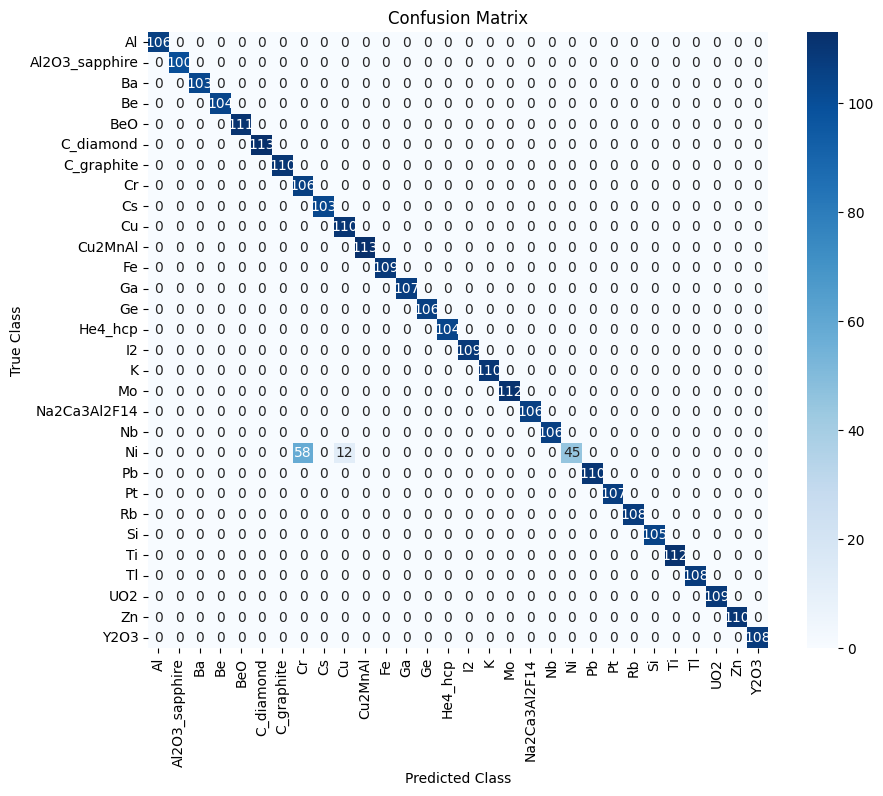

In [53]:
# Вычисляем метрики на всем датасете
accuracy = accuracy_score(all_targets, all_preds)
precision = precision_score(all_targets, all_preds, average='weighted')
recall = recall_score(all_targets, all_preds, average='weighted')
f1 = f1_score(all_targets, all_preds, average='weighted')

print(f"Accuracy: {accuracy:.2f}")
print(f"Precision (Weighted): {precision:.2f}")
print(f"Recall (Weighted): {recall:.2f}")
print(f"F1-Score (Weighted): {f1:.2f}")

# Построение и визуализация матрицы ошибок
conf_matrix = confusion_matrix(all_targets, all_preds)
plt.figure(figsize=(10, 8))
sns.heatmap(conf_matrix, annot=True, fmt="d", cmap="Blues", xticklabels=Crystal_types, yticklabels=Crystal_types)
plt.xlabel("Predicted Class")
plt.ylabel("True Class")
plt.title("Confusion Matrix")
plt.show()